# Strategic asset allocation

In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:85% !important; }</style>"))

In [2]:
import numpy as np
import pandas as pd
import pandas_datareader as web

from matplotlib.ticker import FuncFormatter
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

from datetime import datetime

import yfinance as yf

import scipy.stats as scs
import scipy.optimize as sco
import scipy.interpolate as sci

import statsmodels.api as sm

import seaborn as sns

import plotly.express as px
import plotly.graph_objects as go

import plotly.figure_factory as ff

import functions as f

import os

In [3]:
def statistics(weights):
    
    weights = np.array(weights) 
    pret = np.sum(rets_mean * weights)
    pvol = np.sqrt(np.dot(weights.T, np.dot(sigma, weights)))
    
    return np.array([pret, pvol, pret / pvol])

## Asset classification

#### 1. Cash and money markets
 - T-bill rate
 - Fed funds rate

#### 2. Fixed Income
 - Treasury bonds (iShares US Treas 10y-20y)
 - Investment grade corporate bonds (iShares IG Corp)
 - High-yield bonds (iShares HY Corp)

#### 3. Stock market: 
 -  S&P 500
 - iShares MSCI EAFE
 - iShares MSCI EM
 - Vanguard Real Estate

###### 11 sectors under the Global Industry Classification Standard:
  -  Energy
  -  Materials
  -  Industrials
  -  Utilities
  -  Healthcare
  -  Financials
  -  Consumer Discretionary
  -  Consumer Staples
  -  Information Technology
  -  Communication Services
  -  Real Estate
  
#### 4. Alternative investments

  -  Commodity funds (e.g.: Gold)

In [4]:
stock_tickers= ['^GSPC','EFA','EEM','VNQ','IAU']
fixedincome_tickers = ['TLH', 'LQD','HYG','^IRX']
fed_rates = ['EFFR']
sectors_tickers =['XLE','XLB','XLI','XLU','XLV','XLF','XLY','XLP','XLK','XLC','XLRE']
currency_tickers = ['EURUSD=X', 'GBPUSD=X', 'JPYUSD=X', 'CHFUSD=X', 'BRLUSD=X', 'AUDUSD=X']
data = pd.DataFrame(columns=np.concatenate((stock_tickers, fixedincome_tickers, fed_rates, sectors_tickers)))

In [5]:
for ticker in stock_tickers:
    data[ticker] = yf.download(ticker, period='13y')['Adj Close']
    
    
for ticker in fixedincome_tickers:
    data[ticker] = yf.download(ticker, period='13y')['Adj Close']
   
 
for rate in fed_rates:
    data[rate] = web.DataReader(rate, data_source = 'fred', start = data.index[0])[rate]

for sector in sectors_tickers: 
    data[sector] = yf.download(sector, period='13y')['Adj Close']
    
for currency in currency_tickers:
    data[currency]=yf.download(currency, period='13y')['Adj Close']

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

In [6]:
data

,^GSPC,EFA,EEM,VNQ,IAU,TLH,LQD,HYG,^IRX,EFFR,...,XLP,XLK,XLC,XLRE,EURUSD=X,GBPUSD=X,JPYUSD=X,CHFUSD=X,BRLUSD=X,AUDUSD=X
Date,,,,,,,,,,,,,,,,,,,,,
2007-10-15,1548.709961,56.426220,40.124649,41.749504,7.521000,71.593094,62.883904,44.752228,4.160,4.81,...,19.820147,22.382553,NaN,NaN,1.420394,2.042400,0.008524,0.846812,0.553986,0.900171
2007-10-16,1538.530029,55.555641,39.380981,41.241474,7.518000,71.793526,62.991379,44.581772,4.125,4.68,...,19.735628,22.382553,NaN,NaN,1.417696,2.032190,0.008551,0.846024,0.549632,0.889917
2007-10-17,1541.239990,56.144943,40.290173,41.178692,7.471000,72.380569,63.289822,44.031944,3.890,4.70,...,19.806063,22.569687,NaN,NaN,1.421707,2.039984,0.008584,0.848320,0.554170,0.890631
2007-10-18,1540.079956,56.278885,40.493927,41.190113,7.595000,72.666962,63.295799,44.010635,3.640,4.69,...,19.735628,22.626638,NaN,NaN,1.429490,2.044195,0.008661,0.855139,0.555401,0.896298
2007-10-19,1500.630005,55.039989,38.762104,39.437683,7.583000,73.418663,63.707664,43.814571,3.740,4.77,...,19.531370,22.089659,NaN,NaN,1.429695,2.051492,0.008729,0.856384,0.558503,0.893815
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-09,3477.139893,65.680000,45.830002,83.019997,18.410000,163.899994,134.929993,84.949997,0.093,0.09,...,65.739998,120.180000,60.330002,36.930000,1.176700,1.294046,0.009432,1.090869,0.178616,0.717798
2020-10-12,3534.219971,66.059998,46.230000,83.410004,18.360001,164.320007,135.710007,85.379997,0.090,NaN,...,66.500000,123.459999,61.919998,37.119999,1.181684,1.303169,0.009467,1.098358,0.180865,0.722460
2020-10-13,3511.929932,65.320000,46.040001,81.980003,18.049999,165.169998,135.580002,85.000000,0.093,0.09,...,66.449997,122.669998,61.980000,36.490002,1.181614,1.306575,0.009493,1.100098,0.180842,0.721188


In [7]:
ticker_label =['S&P 500','MSCI EAFE','MSCI EM','Real Estate Index', 
               'Gold', 'US Treas 10y-20y', 'IG Corp',
               'HY Corp', 'T-bill rate', 'Fed Funds Rate',
               'Energy', 'Materials', 'Industrials', 'Utilities', 
               'Healthcare', 'Financials', 'Consumer Discretionary', 
               'Consumer Staples', 'Information Technology', 
               'Communication Services', 'Real Estate',
               'Euro', 'British pound', 'Japanese yen',
              'Swiss franc', 'Brazilian real', 'Australian dolar']

data.columns = ticker_label

We eliminate Communication Services and Real Estate due to incomplete data.

In [8]:
data.drop(['Communication Services', 'Real Estate'], axis=1, inplace = True)

In [9]:
data_assets = data.drop(data.columns[8:], axis=1)
data_rates = pd.DataFrame([data['T-bill rate'], data['Fed Funds Rate']]).transpose()
data_sectors = data.drop(data.columns[:10], axis=1).drop(['Euro', 'British pound', 'Japanese yen',
              'Swiss franc', 'Brazilian real', 'Australian dolar'], axis=1)
data_fxin= pd.DataFrame([data['US Treas 10y-20y'], data['IG Corp'],
               data['HY Corp']]).transpose()
data_curr = data.drop(data.columns[:21], axis=1)

In [10]:
data

,S&P 500,MSCI EAFE,MSCI EM,Real Estate Index,Gold,US Treas 10y-20y,IG Corp,HY Corp,T-bill rate,Fed Funds Rate,...,Financials,Consumer Discretionary,Consumer Staples,Information Technology,Euro,British pound,Japanese yen,Swiss franc,Brazilian real,Australian dolar
Date,,,,,,,,,,,,,,,,,,,,,
2007-10-15,1548.709961,56.426220,40.124649,41.749504,7.521000,71.593094,62.883904,44.752228,4.160,4.81,...,16.694876,30.622187,19.820147,22.382553,1.420394,2.042400,0.008524,0.846812,0.553986,0.900171
2007-10-16,1538.530029,55.555641,39.380981,41.241474,7.518000,71.793526,62.991379,44.581772,4.125,4.68,...,16.383224,30.523447,19.735628,22.382553,1.417696,2.032190,0.008551,0.846024,0.549632,0.889917
2007-10-17,1541.239990,56.144943,40.290173,41.178692,7.471000,72.380569,63.289822,44.031944,3.890,4.70,...,16.373629,30.556355,19.806063,22.569687,1.421707,2.039984,0.008584,0.848320,0.554170,0.890631
2007-10-18,1540.079956,56.278885,40.493927,41.190113,7.595000,72.666962,63.295799,44.010635,3.640,4.69,...,16.167461,30.276638,19.735628,22.626638,1.429490,2.044195,0.008661,0.855139,0.555401,0.896298
2007-10-19,1500.630005,55.039989,38.762104,39.437683,7.583000,73.418663,63.707664,43.814571,3.740,4.77,...,15.630462,29.601988,19.531370,22.089659,1.429695,2.051492,0.008729,0.856384,0.558503,0.893815
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-09,3477.139893,65.680000,45.830002,83.019997,18.410000,163.899994,134.929993,84.949997,0.093,0.09,...,25.230000,153.389999,65.739998,120.180000,1.176700,1.294046,0.009432,1.090869,0.178616,0.717798
2020-10-12,3534.219971,66.059998,46.230000,83.410004,18.360001,164.320007,135.710007,85.379997,0.090,NaN,...,25.510000,155.429993,66.500000,123.459999,1.181684,1.303169,0.009467,1.098358,0.180865,0.722460
2020-10-13,3511.929932,65.320000,46.040001,81.980003,18.049999,165.169998,135.580002,85.000000,0.093,0.09,...,25.020000,155.399994,66.449997,122.669998,1.181614,1.306575,0.009493,1.100098,0.180842,0.721188


In [11]:
fig1 = px.line(data_assets / data_assets.iloc[0] * 100, template = 'plotly_white')
fig1.update_layout( title= "Assets evolution since October 2007",
            xaxis_title="Date",
            yaxis_title="Value",
            legend=dict(
            title_text='Fund',
            orientation="h",
            yanchor="bottom",
            y=-0.3,
            xanchor="right",
            x=1,
            bordercolor="Black",
            borderwidth=0.5
        ))
fig1.show()

In [12]:
fig2 = px.line(data_rates, template = 'plotly_white')
fig2.update_layout(title= "Short term rates since October 2007",
            xaxis_title="Date",
            yaxis_title="Value",
            legend=dict(
            title_text='Rate',
            orientation="h",
            y=-0.2,
            x=0,
            bordercolor="Black",
            borderwidth=0.5
        ))
fig2.show()

In [13]:
fig3 = px.line(data_sectors / data_sectors.iloc[0] * 100, template = 'plotly_white')
fig3.update_layout( title= "Equity sectors evolution since October 2007",
            xaxis_title="Date",
            yaxis_title="Value",
            legend=dict(
            title_text='Sector',
            orientation="h",
            yanchor="bottom",
            y=-0.4,
            xanchor="right",
            x=1,
            bordercolor="Black",
            borderwidth=0.5
        ))
fig3.show()

In [14]:
fig4 = px.line(data_fxin / data_fxin.iloc[0] * 100, template = 'plotly_white')
fig4.update_layout( title= "Fixed income evolution since October 2007",
            xaxis_title="Date",
            yaxis_title="Value",
            legend=dict(
            title_text='Fixed income fund',
            orientation="h",
            yanchor="bottom",
            y=-0.25,
            xanchor="right",
            x=1,
            bordercolor="Black",
            borderwidth=0.5
        ))
fig4.show()

In [15]:
fig5 = px.line(data_curr / data_curr.iloc[0] * 100, template = 'plotly_white')
fig5.update_layout( title= "Currencies evolution since October 2007",
            xaxis_title="Date",
            yaxis_title="Value",
            legend=dict(
            title_text='Currency',
            orientation="h",
            yanchor="bottom",
            y=-0.3,
            xanchor="right",
            x=1,
            bordercolor="Black",
            borderwidth=0.5
        ))
fig5.show()

In [16]:
if not os.path.exists("images"):
    os.mkdir("images")
    
fig1.write_image("images/fig1.jpg", scale=3)
fig2.write_image("images/fig2.jpg", scale=3)
fig3.write_image("images/fig3.jpg", scale=3)
fig4.write_image("images/fig4.jpg", scale=3)
fig5.write_image("images/fig5.jpg", scale=3)

## Assets returns

In [17]:
returns = data_assets.pct_change()*100
print('\n--Asset returns--\n', returns.describe())
returns_to_xls = pd.concat([returns , returns.describe()])


--Asset returns--
            S&P 500    MSCI EAFE      MSCI EM  Real Estate Index         Gold  \
count  3274.000000  3274.000000  3274.000000        3274.000000  3274.000000   
mean      0.033669     0.015359     0.022780           0.042846     0.033615   
std       1.335022     1.503412     1.954854           2.108562     1.153705   
min     -11.984055   -11.163155   -16.166215         -19.513688    -8.845893   
25%      -0.406697    -0.567670    -0.830245          -0.655099    -0.500691   
50%       0.068654     0.059679     0.084094           0.082612     0.065196   
75%       0.580957     0.662728     0.889013           0.766891     0.611274   
max      11.580037    15.887701    22.769842          17.006518    11.698660   

       US Treas 10y-20y      IG Corp      HY Corp  
count       3274.000000  3274.000000  3274.000000  
mean           0.027422     0.025125     0.022433  
std            0.615801     0.575681     0.769719  
min           -5.146223    -9.111174    -8.097384  

## Assets returns per year

In [18]:
returns_asset_year = returns.groupby(data_assets.index.year).sum()
print('\n--Asset return per year--\n', returns_asset_year.describe())


--Asset return per year--
          S&P 500  MSCI EAFE    MSCI EM  Real Estate Index       Gold  \
count  14.000000  14.000000  14.000000          14.000000  14.000000   
mean    7.873793   3.591880   5.327339          10.019903   7.861149   
std    17.310027  18.695019  24.880997          18.070301  15.209549   
min   -40.145891 -41.765811 -42.606930         -19.636433 -30.844402   
25%     1.027490  -5.210765 -11.441179          -0.195200   1.228090   
50%    12.292061   1.734298   3.035906           7.470605  10.097648   
75%    16.895899  19.958629  18.397728          23.887157  16.067138   
max    26.553081  28.914182  60.221929          46.856956  27.205145   

       US Treas 10y-20y    IG Corp    HY Corp  
count         14.000000  14.000000  14.000000  
mean           6.412730   5.875753   5.246126  
std            9.085862   5.522628  10.152380  
min           -8.662968  -3.780307 -15.648708  
25%            1.257247   1.834706  -1.054138  
50%            5.202209   7.440862 

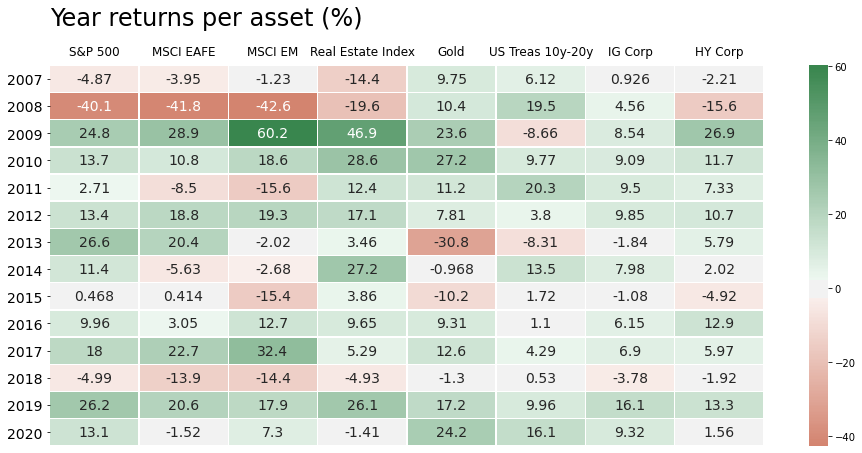

In [19]:
cmap = sns.diverging_palette(h_neg=20, h_pos=135, as_cmap=True)
fig5 = plt.figure(figsize=(16,7))
sns.heatmap(returns_asset_year, annot = True, linewidths=.5, cmap=cmap, fmt=".3g", center=0.0, annot_kws=dict(fontsize=14))
plt.title('Year returns per asset (%)', fontsize = 24, loc = 'left', pad=20)
plt.ylabel('', fontsize = 15)
plt.tick_params(axis='both', which='major', labelbottom = False, bottom=False, labeltop=True)
plt.xticks(rotation=0, fontsize = 12)
plt.yticks(rotation=0, fontsize = 14)
plt.savefig('Assets return2.jpg')

In [20]:
data_matrix = returns_asset_year.describe().round(2)
fig = ff.create_table(data_matrix, index=True)
fig.show()
fig.write_image("images/table2.jpg", scale =2)

## Return year per asset

In [21]:
returns_year = returns_asset_year.T
print('\n--Returns per year--\n', returns_year.describe())


--Returns per year--
 Date        2007       2008       2009       2010       2011       2012  \
count   8.000000   8.000000   8.000000   8.000000   8.000000   8.000000   
mean   -1.228381 -15.663248  26.390017  16.173796   4.928978  12.591994   
std     7.302404  24.925806  21.138915   7.829084  11.738044   5.548186   
min   -14.359973 -42.606930  -8.662968   9.093232 -15.571159   3.798374   
25%    -4.182757 -40.550871  19.807176  10.541345  -0.095682   9.343865   
50%    -1.720355 -17.642570  25.842977  12.666894   8.414768  12.041098   
75%     2.223193   6.031750  33.399875  20.727030  11.536160  17.537102   
max     9.754085  19.494652  60.221929  28.624374  20.290332  19.301385   

Date        2013       2014       2015       2016       2017       2018  \
count   8.000000   8.000000   8.000000   8.000000   8.000000   8.000000   
mean    1.643275   6.608353  -3.140407   8.111957  13.521257  -5.580216   
std    17.612102  10.758628   6.608667   4.316480  10.112395   5.592764   
m

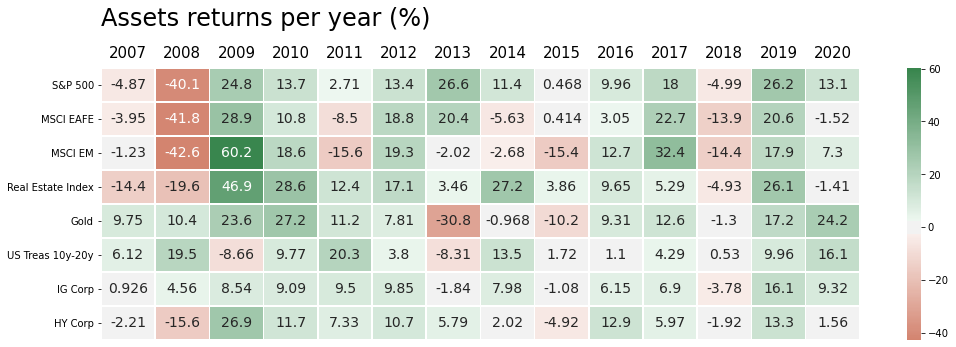

In [22]:
cmap = sns.diverging_palette(h_neg=20, h_pos=135, as_cmap=True)
fig7= plt.figure(figsize=(17,5))
sns.heatmap(returns_year, annot = True, linewidths=.5, cmap=cmap, center=0.0, fmt=".3g", annot_kws=dict(fontsize=14))
plt.title('Assets returns per year (%)', fontsize = 24, loc = 'left',  pad=20)
plt.xlabel('')
plt.tick_params(axis='both', which='major', labelbottom = False, bottom=False, labeltop=True)
plt.xticks(fontsize=15)
plt.savefig('Assets return.jpg')

In [23]:
returns_asset_year = returns.groupby(data_assets.index.year).sum()
print('\n--Asset return per year--\n', returns_asset_year.describe())

data_matrix = returns_year.describe().round(2)
fig = ff.create_table(data_matrix, index=True)
fig.show()
fig.write_image("images/table.jpg", scale =2)


--Asset return per year--
          S&P 500  MSCI EAFE    MSCI EM  Real Estate Index       Gold  \
count  14.000000  14.000000  14.000000          14.000000  14.000000   
mean    7.873793   3.591880   5.327339          10.019903   7.861149   
std    17.310027  18.695019  24.880997          18.070301  15.209549   
min   -40.145891 -41.765811 -42.606930         -19.636433 -30.844402   
25%     1.027490  -5.210765 -11.441179          -0.195200   1.228090   
50%    12.292061   1.734298   3.035906           7.470605  10.097648   
75%    16.895899  19.958629  18.397728          23.887157  16.067138   
max    26.553081  28.914182  60.221929          46.856956  27.205145   

       US Treas 10y-20y    IG Corp    HY Corp  
count         14.000000  14.000000  14.000000  
mean           6.412730   5.875753   5.246126  
std            9.085862   5.522628  10.152380  
min           -8.662968  -3.780307 -15.648708  
25%            1.257247   1.834706  -1.054138  
50%            5.202209   7.440862 

## Returns Correlations per Years

In [24]:
ret_corr_year = returns.groupby(data.index.year).corr()

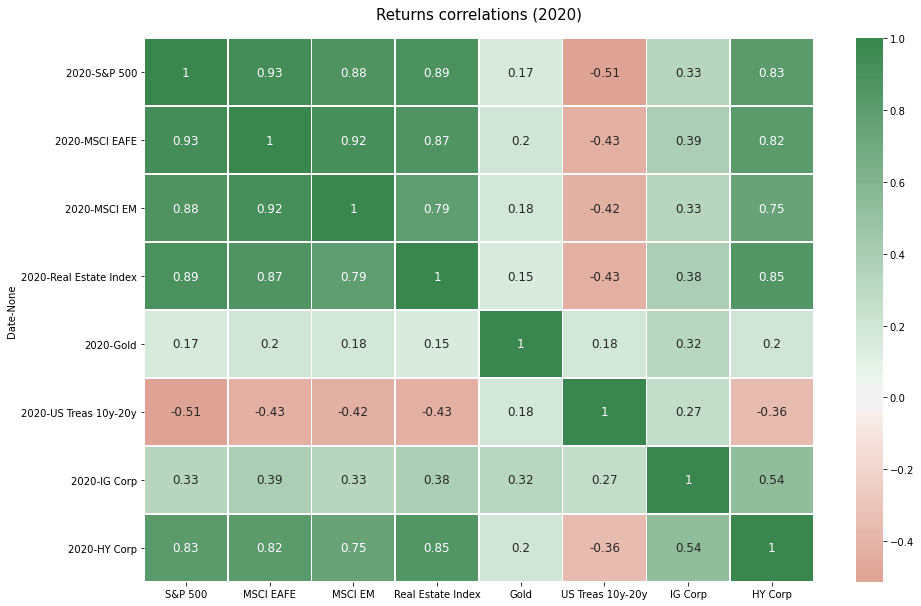

In [25]:
cmap = sns.diverging_palette(h_neg=20, h_pos=135, as_cmap=True)
fig6 = plt.figure(figsize=(15,10))
sns.heatmap(ret_corr_year.iloc[-8:], annot = True, linewidths=.5, cmap=cmap, center=0.0, annot_kws=dict(fontsize=12))
plt.title('Returns correlations (2020)', fontsize=15, pad =20)
plt.savefig('Correlation 2020.jpg')

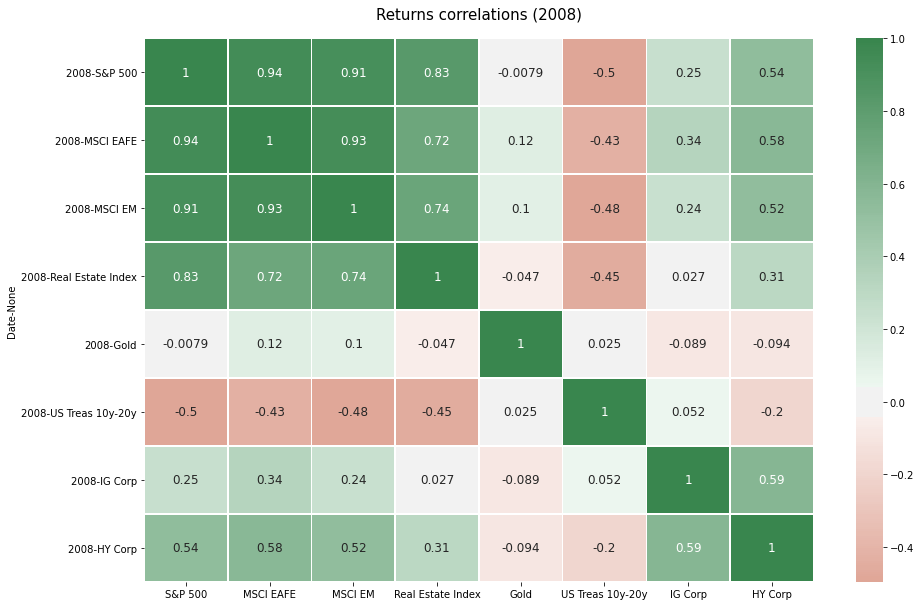

In [26]:
cmap = sns.diverging_palette(h_neg=20, h_pos=135, as_cmap=True)
plt.figure(figsize=(15,10))
sns.heatmap(ret_corr_year.iloc[8:16], annot = True, linewidths=.5, cmap=cmap, center=0.0, annot_kws=dict(fontsize=12))
plt.title('Returns correlations (2008)', fontsize=15, pad=20)
plt.savefig('Correlation 2008.jpg')

## Returns equity

In [27]:
data_sectors['S&P 500'] = data['S&P 500']
data_sectors['Real Estate'] = data['Real Estate Index']

In [28]:
data_sectors = data_sectors[ ['S&P 500'] + [ col for col in data_sectors.columns if col != 'S&P 500' ] ]

In [29]:
new_ticker_label =['S&P 500', 'Energy', 'Materials', 'Industrials', 'Utilities', 
               'Healthcare', 'Financials', 'Cons. Disc.', 
               'Cons. Stap.', 'I.T.', 'Real Estate']

data_sectors.columns = new_ticker_label

In [30]:
eq_returns = data_sectors.pct_change()*100
print('\n--Asset returns--\n', eq_returns.describe())


--Asset returns--
            S&P 500       Energy    Materials  Industrials    Utilities  \
count  3274.000000  3274.000000  3274.000000  3274.000000  3274.000000   
mean      0.033669     0.002654     0.035102     0.040061     0.035942   
std       1.335022     1.989315     1.620947     1.471774     1.259341   
min     -11.984055   -20.141177   -12.412078   -11.344138   -11.357726   
25%      -0.406697    -0.802957    -0.656295    -0.547555    -0.525388   
50%       0.068654     0.035678     0.091854     0.087584     0.094464   
75%       0.580957     0.889093     0.824870     0.705504     0.621360   
max      11.580037    16.474659    14.057640    12.651219    12.793429   

        Healthcare   Financials  Cons. Disc.  Cons. Stap.         I.T.  \
count  3274.000000  3274.000000  3274.000000  3274.000000  3274.000000   
mean      0.047212     0.036885     0.059606     0.041482     0.062136   
std       1.159652     2.231300     1.433415     0.963998     1.450003   
min      -9.86102

In [31]:
returns_sector_year = eq_returns.groupby(data_sectors.index.year).sum()
data_matrix = returns_sector_year.describe().round(2)
fig = ff.create_table(data_matrix, index=True, height_constant=25)
fig.show()
#fig.write_image("images/tablesdasd.jpg")

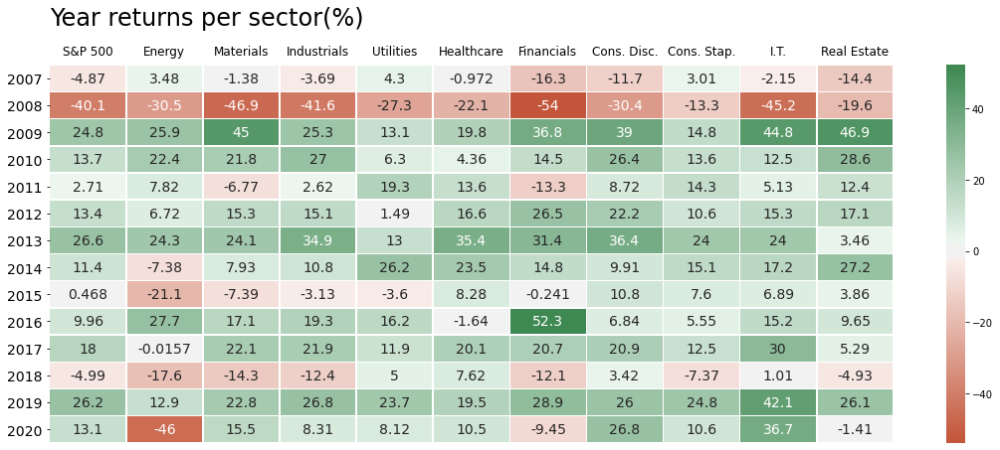

In [32]:
cmap = sns.diverging_palette(h_neg=20, h_pos=135, as_cmap=True)
fig5 = plt.figure(figsize=(19,7))
sns.heatmap(returns_sector_year, annot = True, linewidths=.5, cmap=cmap, fmt=".3g", center=0.0, annot_kws=dict(fontsize=14))
plt.title('Year returns per sector(%)', fontsize = 24, loc = 'left', pad=20)
plt.ylabel('', fontsize = 15)
plt.tick_params(axis='both', which='both', labelbottom = False, bottom=False, labeltop=True)
plt.xticks(rotation=0, fontsize = 12)
plt.yticks(rotation=0, fontsize = 14)
plt.savefig('Equity returns.jpg')

In [33]:
returns_year = returns_sector_year.T
print('\n--Returns per year--\n', returns_year.describe())


--Returns per year--
 Date        2007       2008       2009       2010       2011       2012  \
count  11.000000  11.000000  11.000000  11.000000  11.000000  11.000000   
mean   -4.059381 -33.736917  30.559320  17.383915   6.058578  14.572490   
std     7.158881  12.762685  12.391162   8.350003   9.553658   6.800398   
min   -16.284287 -53.986070  13.123383   4.359346 -13.251425   1.491842   
25%    -8.305564 -43.382398  22.313865  13.090304   2.665413  12.007151   
50%    -2.150844 -30.524621  25.881313  14.477437   7.820916  15.250430   
75%     1.019471 -24.728463  41.862419  24.421947  13.032831  16.868599   
max     4.303109 -13.349711  46.856956  28.624374  19.318114  26.537546   

Date        2013       2014       2015       2016       2017       2018  \
count  11.000000  11.000000  11.000000  11.000000  11.000000  11.000000   
mean   25.240608  14.240844   0.218941  16.196398  16.665629  -5.149854   
std     9.948286   9.750807   9.097672  14.315471   8.549695   8.500917   
m

In [34]:
data_matrix = returns_year.describe().round(2)
fig = ff.create_table(data_matrix, index=True)
fig.show()
#fig.write_image("images/table4.jpg", scale =2)

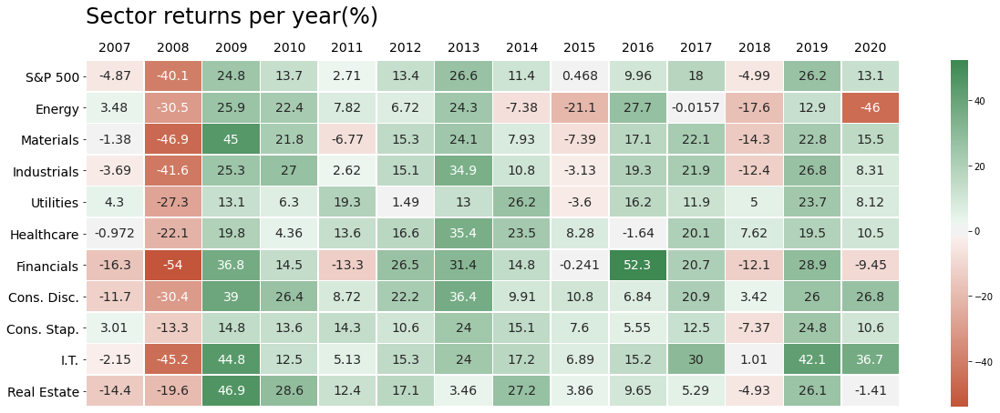

In [35]:
cmap = sns.diverging_palette(h_neg=20, h_pos=135, as_cmap=True)
fig5 = plt.figure(figsize=(20,7))
sns.heatmap(returns_year, annot = True, linewidths=.5, cmap=cmap, fmt=".3g", center=0.0, annot_kws=dict(fontsize=14))
plt.title('Sector returns per year(%)', fontsize = 24, loc = 'left', pad=20)
plt.ylabel('')
plt.xlabel('')
plt.tick_params(axis='both', which='both', labelbottom = False, bottom=False, labeltop=True)
plt.xticks(rotation=0, fontsize = 14)
plt.yticks(rotation=0, fontsize = 14)
plt.savefig('Equity returns2.jpg')

## Portfolio optimization

In [36]:
data_opt = data_assets.drop(data_assets.columns[:3], axis=1)
for sector in data_sectors.columns:
    data_opt[sector] = data_sectors[sector]

In [37]:
data_opt

,Real Estate Index,Gold,US Treas 10y-20y,IG Corp,HY Corp,S&P 500,Energy,Materials,Industrials,Utilities,Healthcare,Financials,Cons. Disc.,Cons. Stap.,I.T.,Real Estate
Date,,,,,,,,,,,,,,,,
2007-10-15,41.749504,7.521000,71.593094,62.883904,44.752228,1548.709961,54.274570,32.094341,31.101259,25.385057,28.423130,16.694876,30.622187,19.820147,22.382553,41.749504
2007-10-16,41.241474,7.518000,71.793526,62.991379,44.581772,1538.530029,54.414074,31.528419,30.964720,25.323122,28.209135,16.383224,30.523447,19.735628,22.382553,41.241474
2007-10-17,41.178692,7.471000,72.380569,63.289822,44.031944,1541.239990,54.065273,31.513515,31.048162,25.391249,28.232906,16.373629,30.556355,19.806063,22.569687,41.178692
2007-10-18,41.190113,7.595000,72.666962,63.295799,44.010635,1540.079956,54.483837,31.759266,31.131586,25.168297,28.240837,16.167461,30.276638,19.735628,22.626638,41.190113
2007-10-19,39.437683,7.583000,73.418663,63.707664,43.814571,1500.630005,51.902657,31.066744,30.266840,24.610939,27.900013,15.630462,29.601988,19.531370,22.089659,39.437683
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-10-09,83.019997,18.410000,163.899994,134.929993,84.949997,3477.139893,30.790001,66.510002,80.709999,63.480000,108.360001,25.230000,153.389999,65.739998,120.180000,83.019997
2020-10-12,83.410004,18.360001,164.320007,135.710007,85.379997,3534.219971,30.870001,66.400002,81.169998,63.880001,109.099998,25.510000,155.429993,66.500000,123.459999,83.410004
2020-10-13,81.980003,18.049999,165.169998,135.580002,85.000000,3511.929932,30.389999,65.809998,80.269997,63.439999,108.269997,25.020000,155.399994,66.449997,122.669998,81.980003


In [38]:
noa = len(data_opt.columns)
rets = np.log(data_opt / data_opt.shift(1)).dropna()
rets_mean= rets.mean() * 252
sigma = rets.cov() * 252

weights = np.zeros((2000,noa))
for i in range(len(weights)):
    weights[i] = f.rand_weights(noa)
    
pret= f.portf_mean(weights, rets_mean)
pvol = np.sqrt(f.portf_var(weights, sigma))

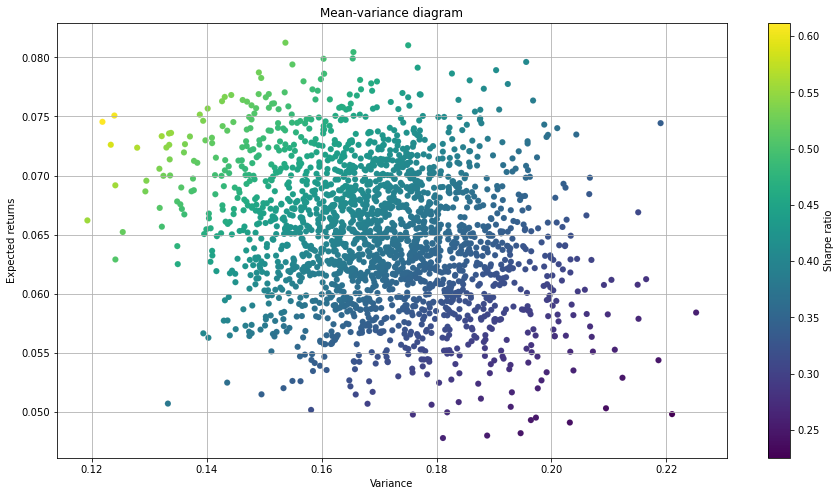

In [39]:
fig = plt.figure(figsize = (15,8))          
plt.scatter(pvol, pret, marker= 'o', lw = 0.1, c = pret/pvol)
plt.grid(True)
plt.title('Mean-variance diagram')
plt.xlabel('Variance')
plt.ylabel('Expected returns')
plt.colorbar(label = 'Sharpe ratio')

In [40]:
def min_func_port(w):
    return statistics(w)[1]

trets = np.linspace(0.025, 0.12)
tvols = []

for tret in trets:
    bnds = tuple((0, 1) for x in range(noa))
    cons = ({'type': 'eq', 'fun': lambda x:  statistics(x)[0] - tret}, 
            {'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})
    res = sco.minimize(min_func_port, noa * [1. / noa,], method='SLSQP',  
                       bounds=bnds, constraints=cons)
    tvols.append(res['fun'])
       
tvols = np.array(tvols)

ex_weights = np.zeros((10000,noa))
for i in range(len(ex_weights)):
    ex_weights[i] = f.extreme_weights(noa)
    
new_weights = np.concatenate((weights, ex_weights, np.identity(noa)))

pret= f.portf_mean(new_weights, rets_mean)
pvol = np.sqrt(f.portf_var(new_weights, sigma))

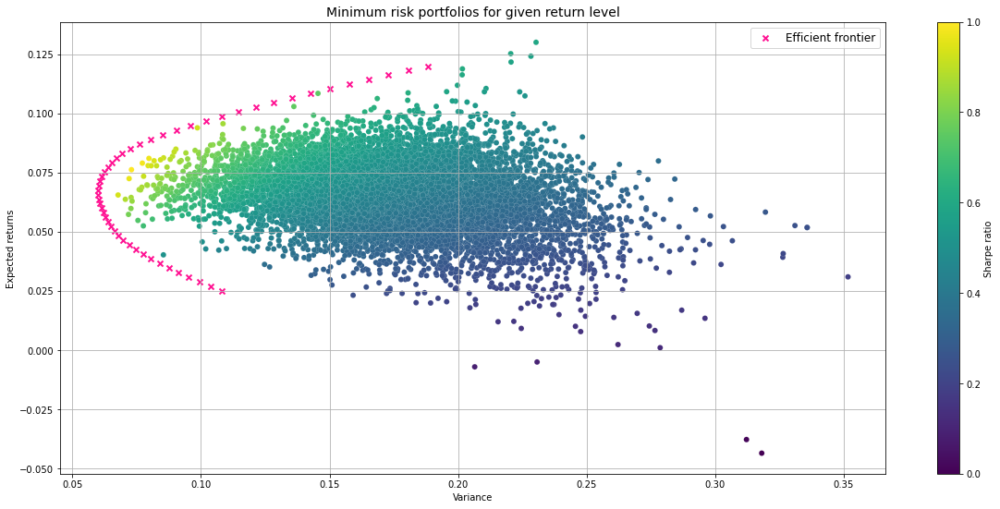

In [41]:
plt.figure(figsize=(20,9))

plt.scatter(pvol, pret, marker= 'o', lw = 0.1, c = pret/pvol, edgecolors='w')

plt.scatter(tvols, trets, c = 'deeppink', marker='x', label='Efficient frontier', lw = 2)

plt.grid(True)
plt.title('Minimum risk portfolios for given return level', fontsize = 14)
plt.xlabel('Variance')
plt.ylabel('Expected returns')
plt.colorbar(label='Sharpe ratio')
plt.legend(fontsize=12, loc = 'best')

In [42]:
ind = np.argmin(tvols)
evols = tvols[ind:]
erets = trets[ind:]

tck = sci.splrep(evols, erets)

In [43]:
def g(x):
    '''Efficient frontier function (splines approximation)'''
    return sci.splev(x, tck, der = 0)

In [44]:
Rf = data_rates.mean()[0]/100

Sp = []
for sigma, mu in zip(evols, g(evols)):
     Sp.append((mu - Rf)/sigma)
        
sigma_T = np.linspace(0.0, 0.10)
E_T = Rf + max(Sp)*sigma_T

TP = np.argmax((g(evols)-Rf)/evols)

Text(0.5, 1.0, 'Capital market line and tangency portfolio')

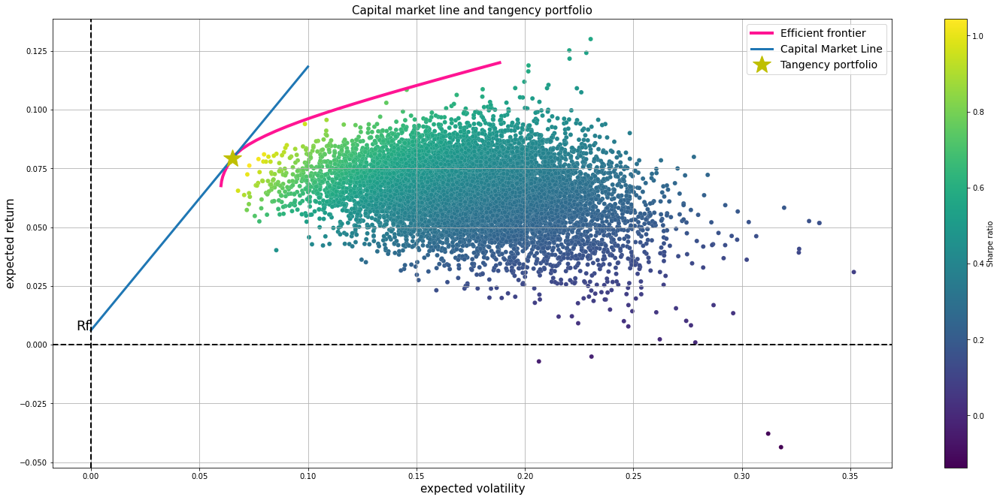

In [45]:
plt.figure(figsize=(25,11))

# random portfolio composition
plt.scatter(pvol, pret, marker= 'o', lw = 0.1, c = pret/pvol, edgecolors='w')

# efficient frontier
plt.plot(evols, erets, 'deeppink', lw=4, label='Efficient frontier')

# capital market line
plt.plot(sigma_T, E_T, lw = 3, label= 'Capital Market Line')

# tangency portfolio
plt.plot(evols[TP], erets[TP], 'y*', markersize=25.0, label='Tangency portfolio')

# risk free rate
plt.text(-0.007, Rf, 'Rf', fontsize = 18)

plt.grid(True)
plt.axhline(0, color='k', ls='--', lw=2.0)
plt.axvline(0, color='k', ls='--', lw=2.0)
plt.xlabel('expected volatility', fontsize = 15)
plt.ylabel('expected return', fontsize = 15)
plt.colorbar(label='Sharpe ratio')
plt.legend(fontsize=14)
plt.title('Capital market line and tangency portfolio', fontsize = 15)

## Rolling Window moments

In [46]:
rets = np.log(data_opt / data_opt.shift(1)).dropna()
rets_rw_mean = np.round(rets.rolling(252).mean() * 252,4).dropna()
rets_rw_std = np.round(rets.rolling(252).std() * np.sqrt(252),4).dropna()
rets_rw_sr = rets_rw_mean.div(rets_rw_std)
rets_rw_cov = np.round(rets.rolling(252).cov() * np.sqrt(252),4).dropna()

In [47]:
fig = px.line(rets_rw_mean, template = 'plotly_white')
fig.update_layout(title= ' Rolling window historical mean return',
                 xaxis_title = 'Time',
                 yaxis_title = 'Mean return',
                 )
fig.show()

In [48]:
fig = px.line(rets_rw_std, template = 'plotly_white')
fig.update_layout(title= ' Rolling window historical sd return',
                 xaxis_title = 'Time',
                 yaxis_title = 'Mean return',
                 )
fig.show()

## Dynamic efficient portfolio

t=0

In [49]:
rets_mean=rets_rw_mean.iloc[0]
sigma = rets_rw_cov.iloc[0:noa]

In [50]:
weights = np.zeros((2000,noa))
for i in range(len(weights)):
    weights[i] = f.rand_weights(noa)
    
pret= f.portf_mean(weights, rets_mean)
pvol = np.sqrt(f.portf_var(weights, sigma))

In [51]:
trets = np.linspace(0.025, 0.12)
tvols = []

for tret in trets:
    bnds = tuple((0, 1) for x in range(noa))
    cons = ({'type': 'eq', 'fun': lambda x:  statistics(x)[0] - tret}, 
            {'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})
    res = sco.minimize(min_func_port, noa * [1. / noa,], method='SLSQP',  
                       bounds=bnds, constraints=cons)
    tvols.append(res['fun'])
       
tvols = np.array(tvols)

ex_weights = np.zeros((10000,noa))
for i in range(len(ex_weights)):
    ex_weights[i] = f.extreme_weights(noa)
    
new_weights = np.concatenate((weights, ex_weights, np.identity(noa)))

pret= f.portf_mean(new_weights, rets_mean)
pvol = np.sqrt(f.portf_var(new_weights, sigma))

In [52]:
ind = np.argmin(tvols)
evols = tvols[ind:]
erets = trets[ind:]

tck = sci.splrep(evols, erets)

ValueError: Error on input data

In [ ]:
Rf = data_rates.iloc[0][0]/100

Sp = []
for sigma, mu in zip(evols, g(evols)):
     Sp.append((mu - Rf)/sigma)
        
sigma_T = np.linspace(0.0, 0.20)
E_T = Rf + max(Sp)*sigma_T

TP = np.argmax((g(evols)-Rf)/evols)

In [ ]:
cons = ({'type': 'eq', 'fun': lambda x:  statistics(x)[0] - erets[TP]}, 
        {'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})
res = sco.minimize(min_func_port, noa * [1. / noa,], method='SLSQP',bounds=bnds, constraints=cons)

In [ ]:
keys = data_opt.columns
values = res['x'].round(4)
res = {keys[i]: values[i] for i in range(len(keys))} 
res

In [ ]:
plt.figure(figsize=(25,11))

# random portfolio composition
plt.scatter(pvol, pret, marker= 'o', lw = 0.1, c = (pret-Rf)/pvol, edgecolors='w')

# efficient frontier
plt.plot(evols, erets, 'deeppink', lw=4, label='Efficient frontier')

# capital market line
plt.plot(sigma_T, E_T, lw = 3, label= 'Capital Market Line')

# tangency portfolio
plt.plot(evols[TP], erets[TP], 'y*', markersize=25.0, label='Tangency portfolio')

# risk free rate
plt.text(-0.01, Rf, 'Rf', fontsize = 18)

plt.grid(True)
plt.axhline(0, color='k', ls='--', lw=2.0)
plt.axvline(0, color='k', ls='--', lw=2.0)
plt.xlabel('expected volatility', fontsize = 15)
plt.ylabel('expected return', fontsize = 15)
plt.colorbar(label='Sharpe ratio')
plt.legend(fontsize=14)
plt.title('Capital market line and tangency portfolio', fontsize = 15)

In [ ]:
dyn_weights = pd.DataFrame(columns = data_opt.columns)

for i in range(20):
    rets_mean=rets_rw_mean.iloc[i]
    sigma = rets_rw_cov.iloc[i*noa:i*noa+noa]
    
    weights = np.zeros((2000,noa))
    for j in range(len(weights)):
        weights[j] = f.rand_weights(noa)
    
    pret= f.portf_mean(weights, rets_mean)
    pvol = np.sqrt(f.portf_var(weights, sigma))

    trets = np.linspace((min(pret)+max(pret))/2, max(pret)/2)
    tvols = []

    for tret in trets:
        bnds = tuple((0, 1) for x in range(noa))
        cons = ({'type': 'eq', 'fun': lambda x:  statistics(x)[0] - tret}, 
                {'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})
        res = sco.minimize(min_func_port, noa * [1. / noa,], method='SLSQP',  
                           bounds=bnds, constraints=cons)
        tvols.append(res['fun'])
       
    tvols = np.array(tvols)

    ind = np.argmin(tvols)
    evols = tvols[ind:]
    erets = trets[ind:]

    tck = sci.splrep(evols, erets)
    
    Rf = data_rates.iloc[i][0]/100

    Sp = []
    for sigma, mu in zip(evols, g(evols)):
         Sp.append((mu - Rf)/sigma)
        
    sigma_T = np.linspace(0.0, 0.20)
    E_T = Rf + max(Sp)*sigma_T

    TP = np.argmax((g(evols)-Rf)/evols)
    
    cons = ({'type': 'eq', 'fun': lambda x:  statistics(x)[0] - erets[TP]}, 
            {'type': 'eq', 'fun': lambda x:  np.sum(x) - 1})
    res = sco.minimize(min_func_port, noa * [1. / noa,], method='SLSQP',
                       bounds=bnds, constraints=cons)
    
    dyn_weights.loc[i]=res['x'].round(4).tolist()

In [ ]:
dyn_weights